In [1]:
#import libraries
import scanpy as sc
import matplotlib as mpl
from matplotlib.pyplot import rcParams
import seaborn as sns

In [2]:
#settings
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.set_figure_params(color_map='viridis')
sc.settings.set_figure_params(dpi=80, facecolor='white')

/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.10.3 anndata==0.10.6 umap==0.5.5 numpy==1.26.4 scipy==1.11.4 pandas==2.2.1 scikit-learn==1.4.1.post1 statsmodels==0.14.1 igraph==0.11.5 pynndescent==0.5.11


In [3]:
#results file
results_file = '/Users/rvi33352/Documents/sc RNA seq analysis/results files/JupyterLW_Scanpy.h5ad'  # the file that will store the analysis results

In [4]:
#read h5 OR h5ac
adata = sc.read_10x_h5(filename = '/Users/rvi33352/Documents/sc RNA seq analysis/Phex/WT/filtered_feature_bc_matrix.h5')
#adata = sc.read_h5ad(filename = 'previous results file here')
adata

reading /Users/rvi33352/Documents/sc RNA seq analysis/Phex/WT/filtered_feature_bc_matrix.h5
 (0:00:00)


/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 9719 × 33696
    var: 'gene_ids', 'feature_types', 'genome'

In [5]:
adata.var_names_make_unique()

normalizing counts per cell
    finished (0:00:00)


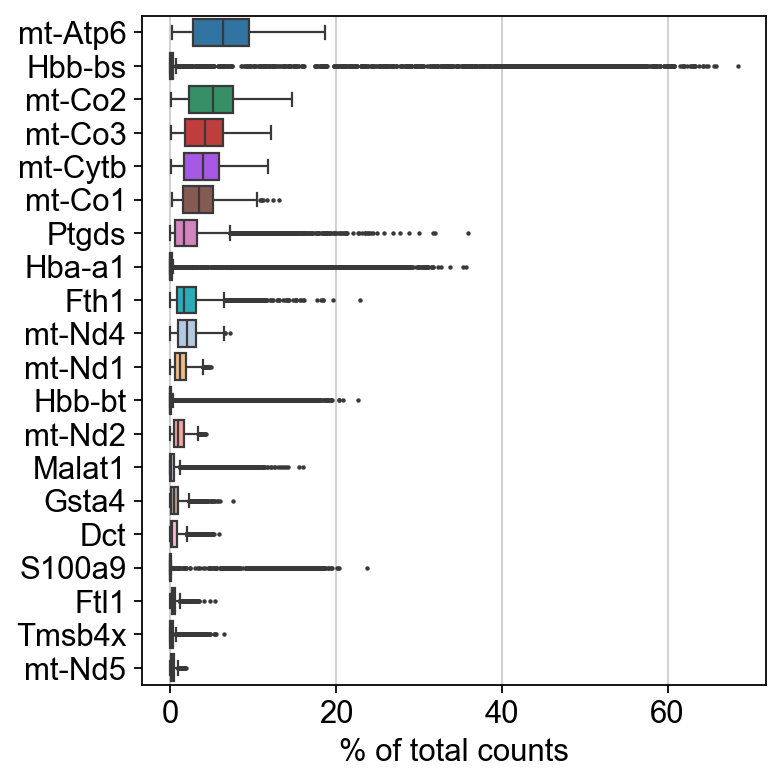

In [6]:
#highest expressed genes
sc.pl.highest_expr_genes(adata, n_top=20, )

filtered out 72 cells that have less than 100 genes expressed
filtered out 14060 genes that are detected in less than 3 cells
Running Scrublet
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Automatically set threshold at doublet score = 0.53
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%
    Scrublet finished (0:00:49)


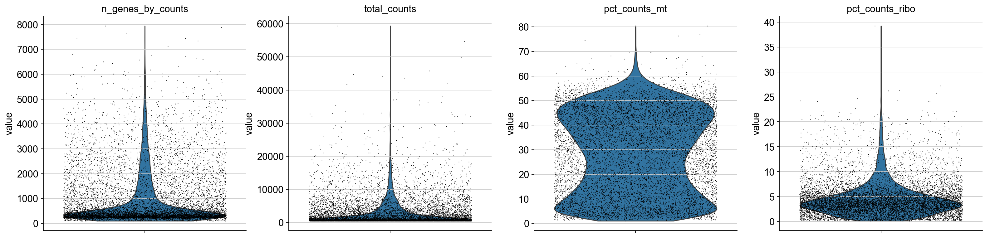

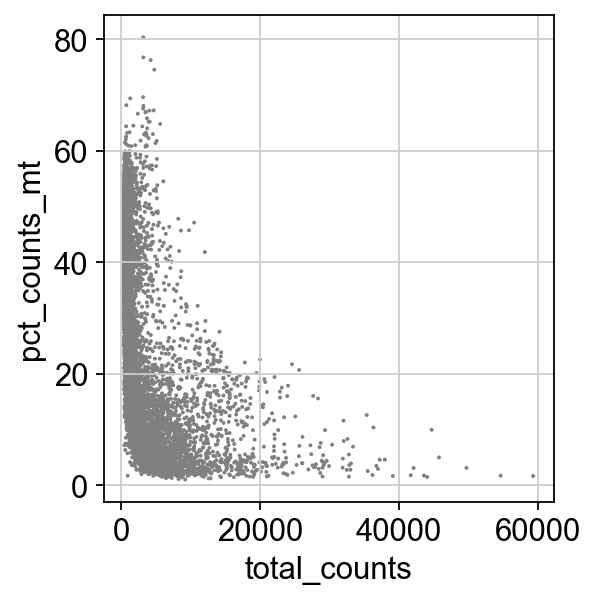

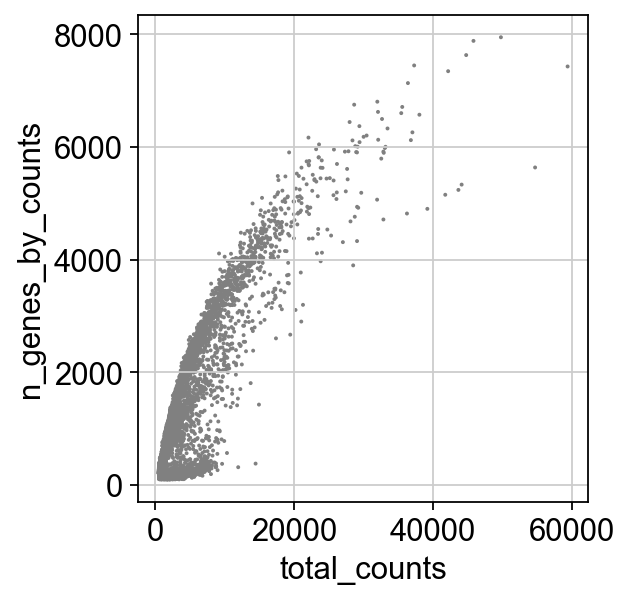

In [7]:
#filtering and normalization
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=3)
sc.pp.scrublet(adata)
adata.var['mt'] = adata.var_names.str.startswith('mt-')
adata.var["ribo"] = adata.var_names.str.startswith(("Rps", "Rpl"))
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo"], inplace=True, log1p=True
)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo'],
             jitter=0.4, multi_panel=True)
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

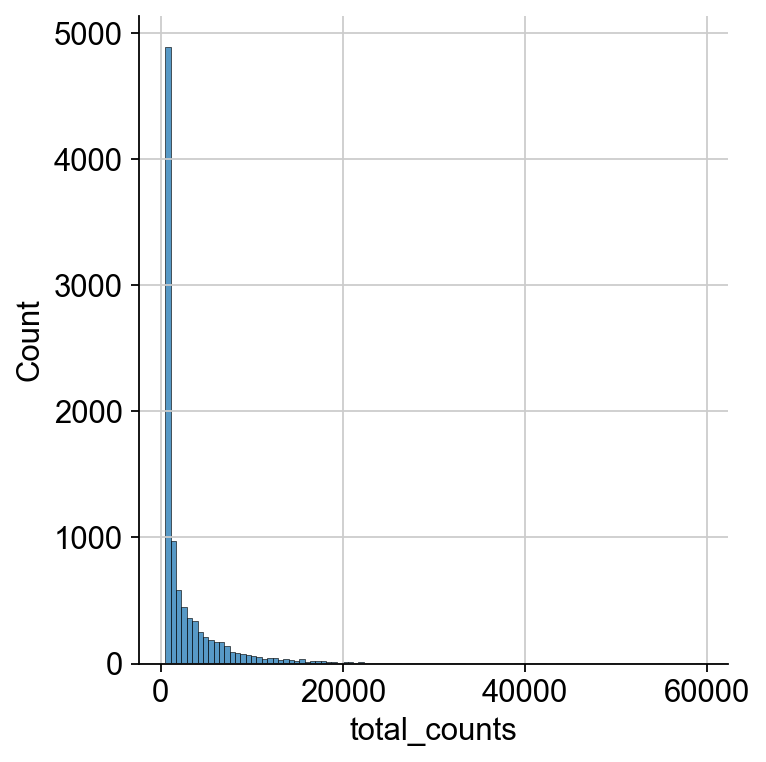

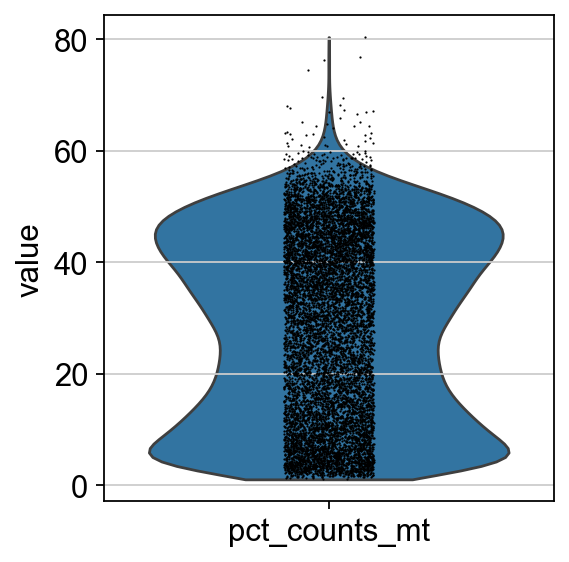

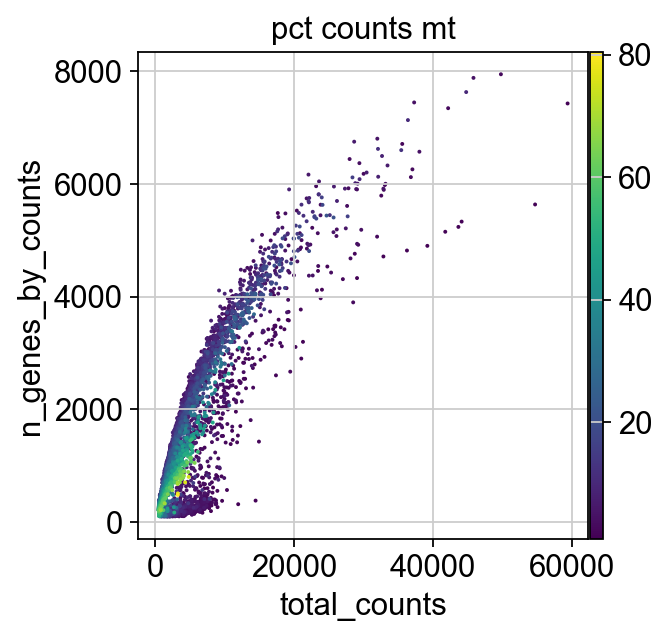

In [8]:
p1 = sns.displot(adata.obs["total_counts"], bins=100, kde=False)
# sc.pl.violin(adata, 'total_counts')
p2 = sc.pl.violin(adata, "pct_counts_mt")
p3 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

In [9]:
#filtering counts, no Mt rna, skipping this step for now
#adata = adata[adata.obs.n_genes_by_counts < 2500, :]

In [10]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

normalizing counts per cell
    finished (0:00:00)


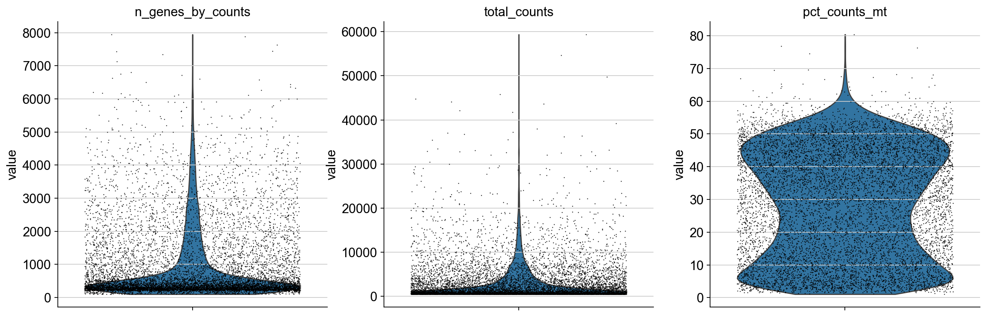

In [11]:
#view filtered QC metrics
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


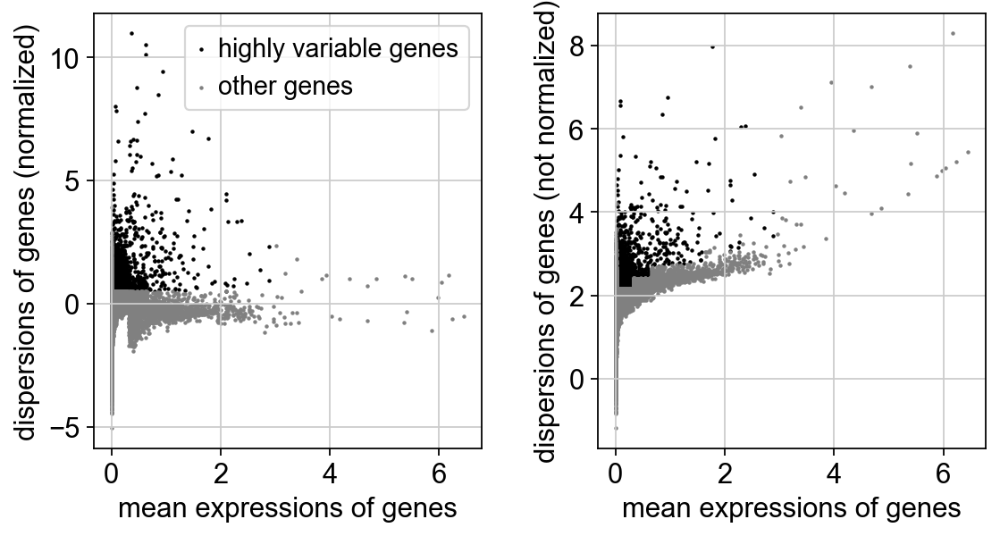

In [12]:
#identify highly variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)

In [13]:
adata

AnnData object with n_obs × n_vars = 9647 × 19636
    obs: 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'scrublet', 'log1p', 'hvg'

In [14]:
#set raw data
adata.raw = adata

In [15]:
#filter highly variable genes only
adata = adata[:, adata.var.highly_variable]

In [16]:
sc.pp.scale(adata, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [17]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20)

computing neighbors
computing PCA
    with n_comps=20


/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/scanpy/tools/_utils.py:41: UserWarning: You’re trying to run this on 4638 dimensions of `.X`, if you really want this, set `use_rep='X'`.
         Falling back to preprocessing with `sc.pp.pca` and default params.
  warnings.warn(


    finished (0:00:01)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)


In [18]:
#compute PCA
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    with n_comps=50
    finished (0:00:03)


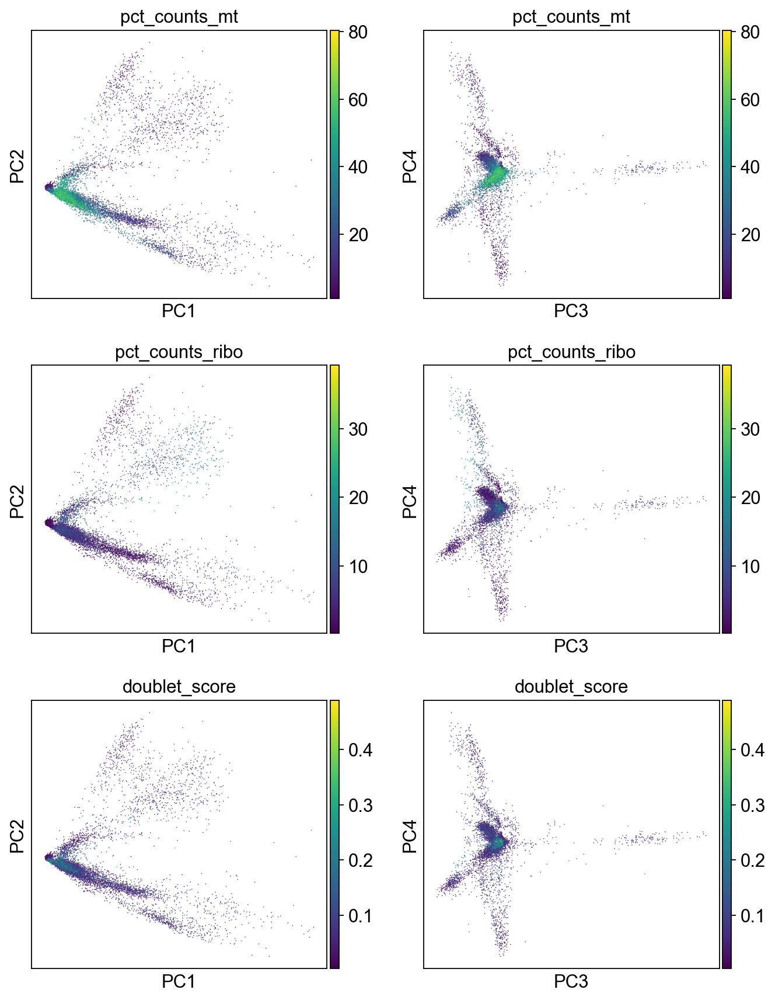

In [19]:
#Plot PCA looking at distribution of Mt-pct, ribo-pct, and doublet score in PC1-4
sc.pl.pca(
    adata,
    color=["pct_counts_mt", "pct_counts_mt", "pct_counts_ribo", "pct_counts_ribo", "doublet_score", "doublet_score"],
    dimensions=[(0, 1), (2, 3), (0, 1), (2, 3), (0, 1), (2, 3)],
    ncols=2,
    size=2,
)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:08)


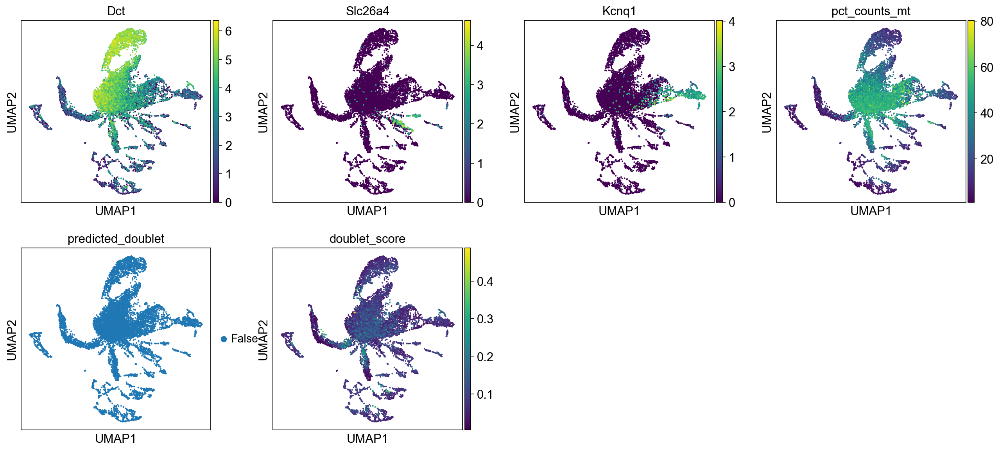

In [20]:
#compute and plot UMAP with SV/LW marker genes
sc.tl.umap(adata) 
sc.pl.umap(adata, color=['Dct', 'Slc26a4', 'Kcnq1', "pct_counts_mt", "predicted_doublet", "doublet_score"]) 

In [21]:
#cluster and plot at different resolutions to identify optimal one
for res in [0.02, 0.5, 1.0, 2.0]:
    sc.tl.leiden(
        adata, key_added=f"leiden_res_{res:4.2f}", resolution=res,
    )

running Leiden clustering


/var/folders/hc/zpcxpzxn4595ny8kwvhby8m81lyslp/T/ipykernel_34646/2149974187.py:3: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(


    finished: found 6 clusters and added
    'leiden_res_0.02', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 23 clusters and added
    'leiden_res_0.50', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 31 clusters and added
    'leiden_res_1.00', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 44 clusters and added
    'leiden_res_2.00', the cluster labels (adata.obs, categorical) (0:00:00)


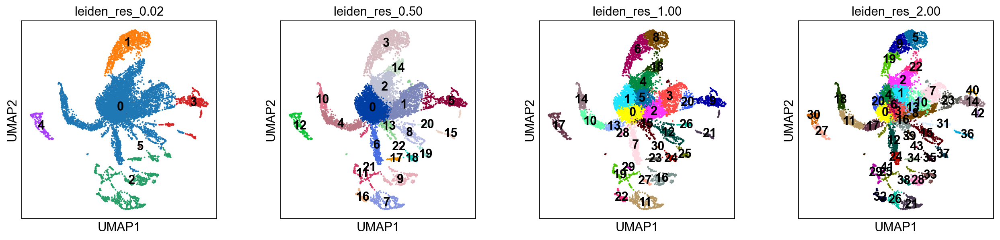

In [22]:
sc.pl.umap(
    adata,
    color=["leiden_res_0.02", "leiden_res_0.50", "leiden_res_1.00", "leiden_res_2.00"],
    legend_loc="on data",
)

In [23]:
#define known marker genes
marker_genes = {
    "Marginal": ["Kcne1", "Kcnq1", "Atp1b2", "Slc12a2"],
    "Intermediate": ["Kcnj10", "Met", "Ednrb", "Dct", "Pax3", "Cd44", "Nrp2", "Tyr"],
    "Basal": ["Gjb2", "Cldn11", "Tjp1", "Atp6v0a4"],
    "Spindle/Root Cells": ["Slc26a4", "Anxa1", "Epyc"],
    "Fibrocytes": ["Otos", "Car3", "Car2", "Slc12a2", "Gjb2", "Igfbp2"],
    "Endothelial Cells": ["Esam", "Pecam1"],
    "Pericytes": ["Rgs5"],
    "Smooth Muscle": ["Tagln", "Anxa1", "Myh11"],
    "Macrophages": ["Cx3cr1"],
    "CD14+ Mono": ["Cd14"],
    "CD16+ Mono": ["Tcf7l2", "Lyn"],
    "Erythroblast": ["Mki67"],
    "NK": ["Nkg7", "Cd247", "Fcer1g", "Tyrobp"],
    "Naive CD20+ B": ["Ms4a1", "Ighd", "Fcrl1", "Ighm"],
    "B cells": ["Ms4a1", "Itgb1", "Col4a4", "Prdm1", "Irf4", "Pax5", "Bcl11a", "Blk", "Ighd", "Ighm"],
    "Plasma cells": ["Mzb1", "Hsp90b1", "Fndc3b", "Prdm1", "Igkc", "Jchain"],
    "Plasmablast": ["Xbp1", "Prdm1", "Pax5"],
    "CD4+ T": ["Cd4", "Il7r", "Trbc2"],
    "CD8+ T": ["Cd8a", "Gzma", "Ccl5", "Gzmb"],
    "T naive": ["Lef1", "Ccr7", "Tcf7"],
    "Neutrophils": ["Stfa2l1", "Ly6g"],
    "Reissner's Membrane": ["Vmo1"],
    "TBC": ["Coch", "Emilin2"],
    "Spiral ligament": ["Slc1a3"],
    "Supporting Cells": ["Sox2", "Cdkn1b"],
    "Hair Cells": ["Otof", "Ocm",],
    "Schwann Cells": ["Mpz", "Mbp", "Plp1"],
    "SGNs": ["Nefh", "Thy1", "Tubb3"]
 }

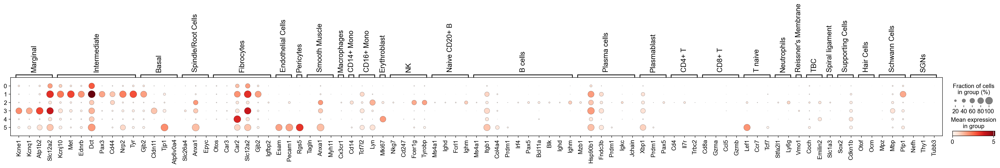

In [24]:
#View marker genes at various Leiden resolutions
sc.pl.dotplot(adata, marker_genes, groupby='leiden_res_0.02');

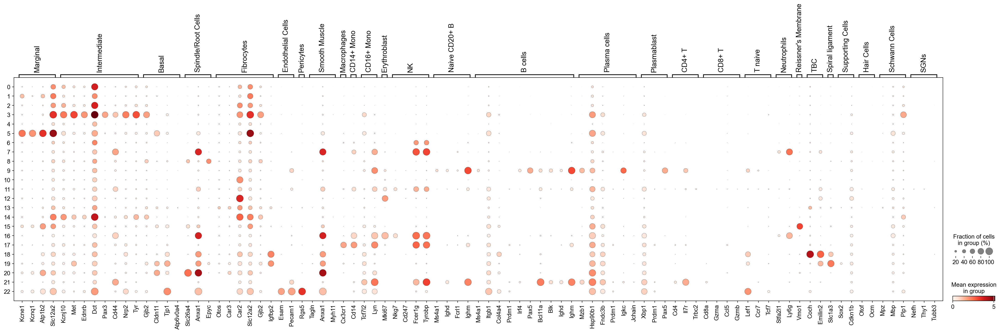

In [25]:
sc.pl.dotplot(adata, marker_genes, groupby='leiden_res_0.50');

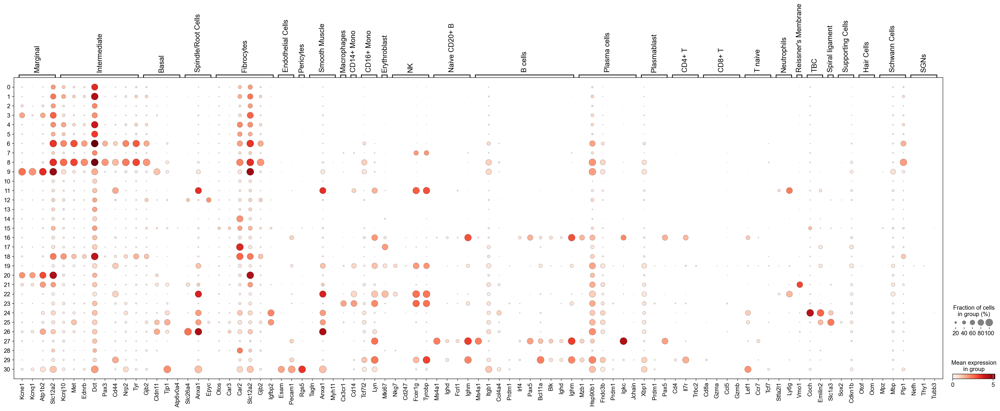

In [26]:
#View marker genes at various Leiden resolutions
sc.pl.dotplot(adata, marker_genes, groupby='leiden_res_1.00');

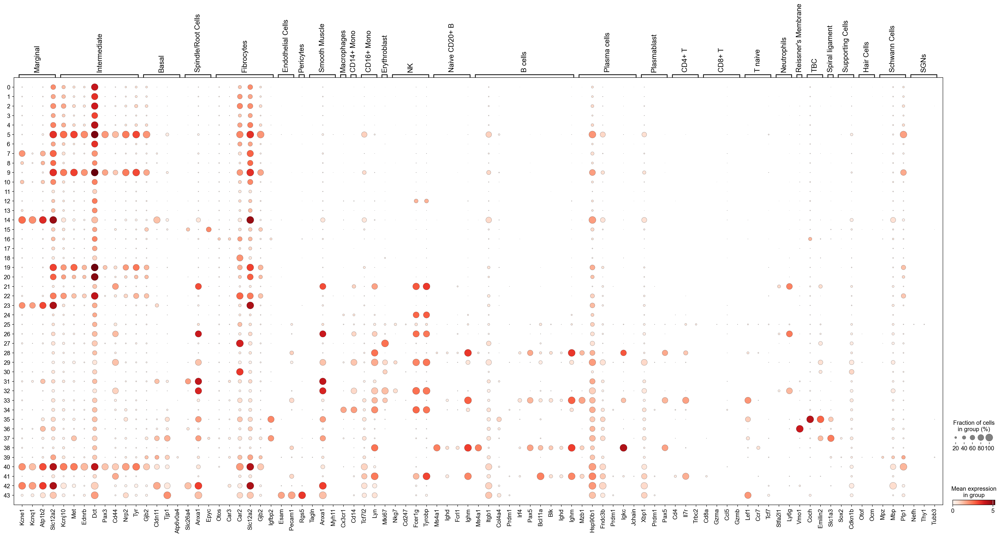

In [27]:
#View marker genes at various Leiden resolutions
sc.pl.dotplot(adata, marker_genes, groupby='leiden_res_2.00');

In [28]:
#identify top DEGs per cluster at res=2 to maximize granularity of empty clusters
sc.tl.rank_genes_groups(adata, groupby="leiden_res_2.00", method="wilcoxon")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/scanpy/tools/_rank_genes_grou

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_res_2.00']`


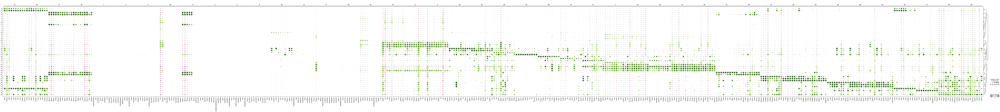

In [29]:
#plot top DEGs per cluster
sc.pl.rank_genes_groups_dotplot(
    adata,
    n_genes=10,
    values_to_plot="logfoldchanges",
    min_logfoldchange=3,
    vmax=7,
    vmin=-7,
    cmap="PiYG",
)

In [30]:
#Empty clusters = 1, 2, 4, 20, 3, 0, 6, 13, 8, 10, 22

In [31]:
#subset out empty clusters
adata_subset = adata[adata.obs['leiden_res_2.00'].isin(['5', '7', '9', '11', '12', '14', '15', '16', '17', '18', '19', '21', '23', '24', '25', '26', '27', '28', '29',
                                                       '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43'])]

In [32]:
adata_subset

View of AnnData object with n_obs × n_vars = 5157 × 4638
    obs: 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'leiden_res_0.02', 'leiden_res_0.50', 'leiden_res_1.00', 'leiden_res_2.00'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'scrublet', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'predicted_doublet_colors', 'leiden_res_0.02', 'leiden_res_0.50', 'leiden_res_1.00', 'leiden_res_2.00', 'leiden_res_0.02_colors', 'leiden_

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing PCA
    with n_comps=50
    finished (0:00:02)


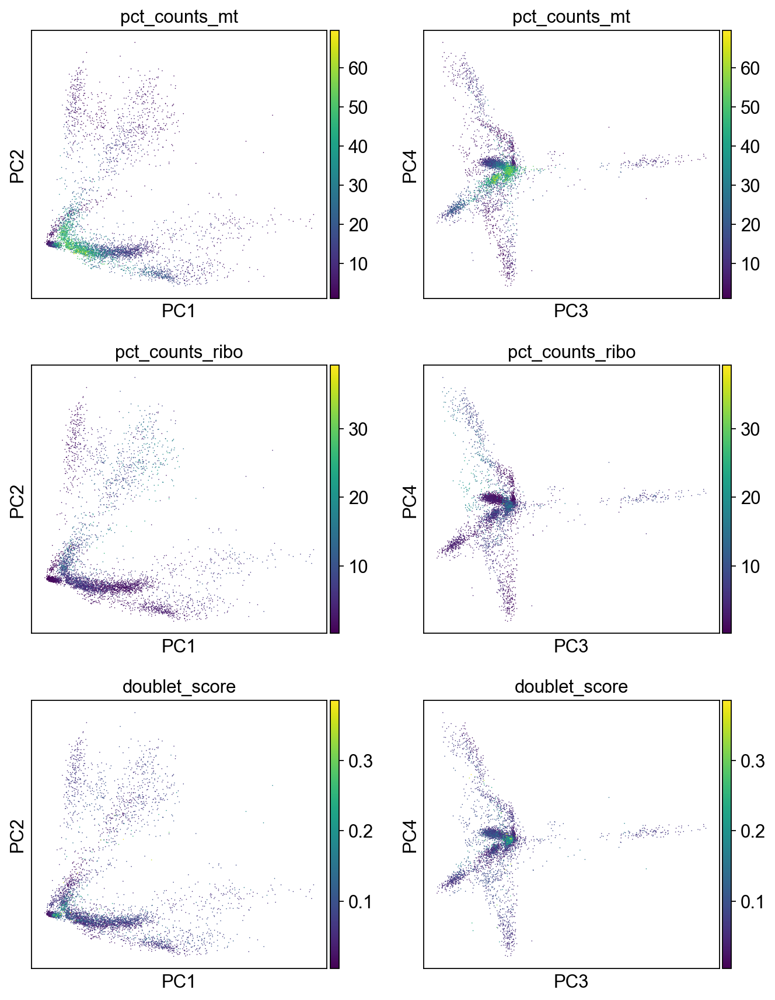

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:04)


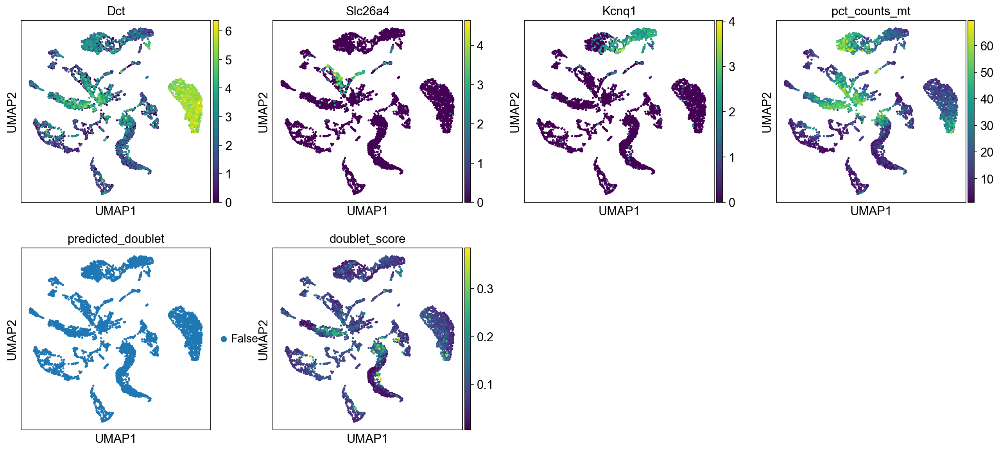

In [33]:
#reprocess remaining cells
sc.pp.neighbors(adata_subset, n_neighbors=10, n_pcs=20)
sc.tl.pca(adata_subset, svd_solver='arpack')
#Plot PCA looking at distribution of Mt-pct, ribo-pct, and doublet score in PC1-4
sc.pl.pca(
    adata_subset,
    color=["pct_counts_mt", "pct_counts_mt", "pct_counts_ribo", "pct_counts_ribo", "doublet_score", "doublet_score"],
    dimensions=[(0, 1), (2, 3), (0, 1), (2, 3), (0, 1), (2, 3)],
    ncols=2,
    size=2,
)
#compute and plot UMAP with SV/LW marker genes
sc.tl.umap(adata_subset) 
sc.pl.umap(adata_subset, color=['Dct', 'Slc26a4', 'Kcnq1', "pct_counts_mt", "predicted_doublet", "doublet_score"]) 

In [34]:
#cluster and plot at different resolutions to identify optimal one
for res in [0.02, 0.5, 1.0, 2.0]:
    sc.tl.leiden(
        adata_subset, key_added=f"leiden_res_{res:4.2f}", resolution=res,
    )

running Leiden clustering
    finished: found 7 clusters and added
    'leiden_res_0.02', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 24 clusters and added
    'leiden_res_0.50', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 35 clusters and added
    'leiden_res_1.00', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 45 clusters and added
    'leiden_res_2.00', the cluster labels (adata.obs, categorical) (0:00:00)


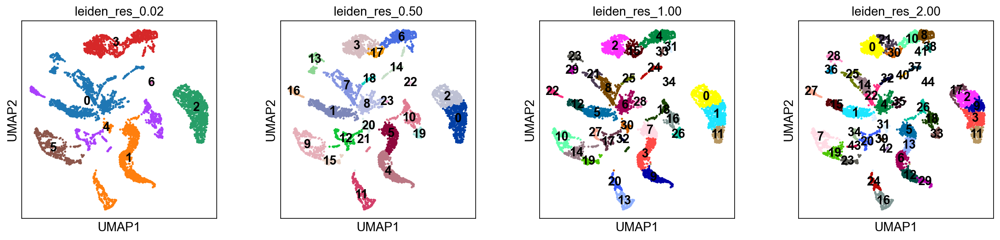

In [35]:
sc.pl.umap(
    adata_subset,
    color=["leiden_res_0.02", "leiden_res_0.50", "leiden_res_1.00", "leiden_res_2.00"],
    legend_loc="on data",
)

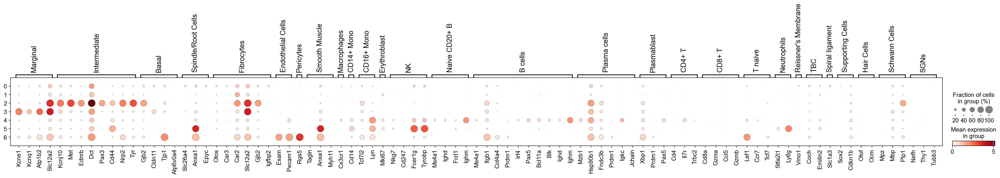

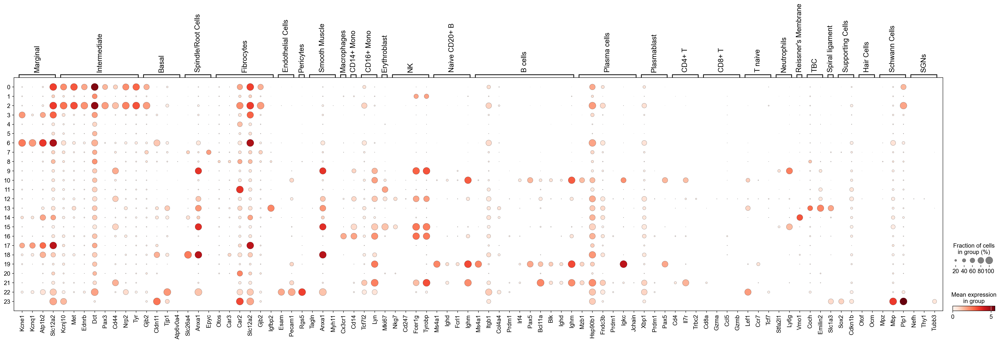

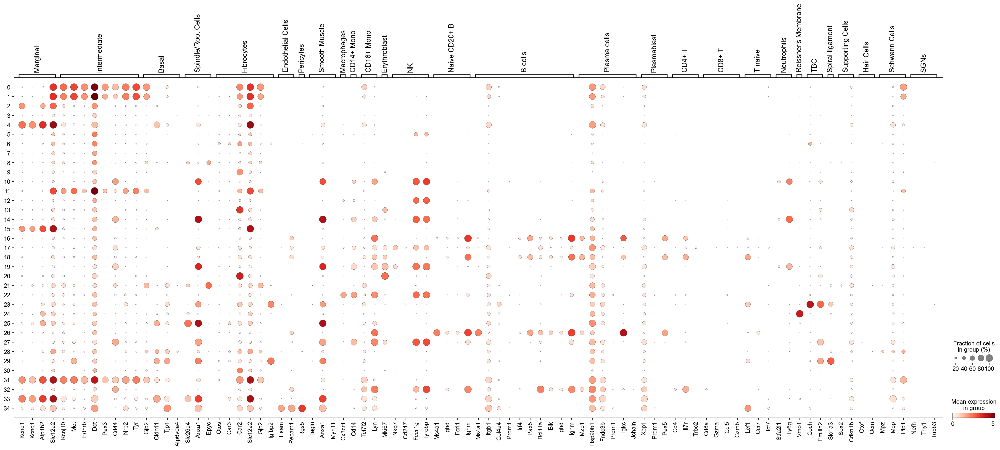

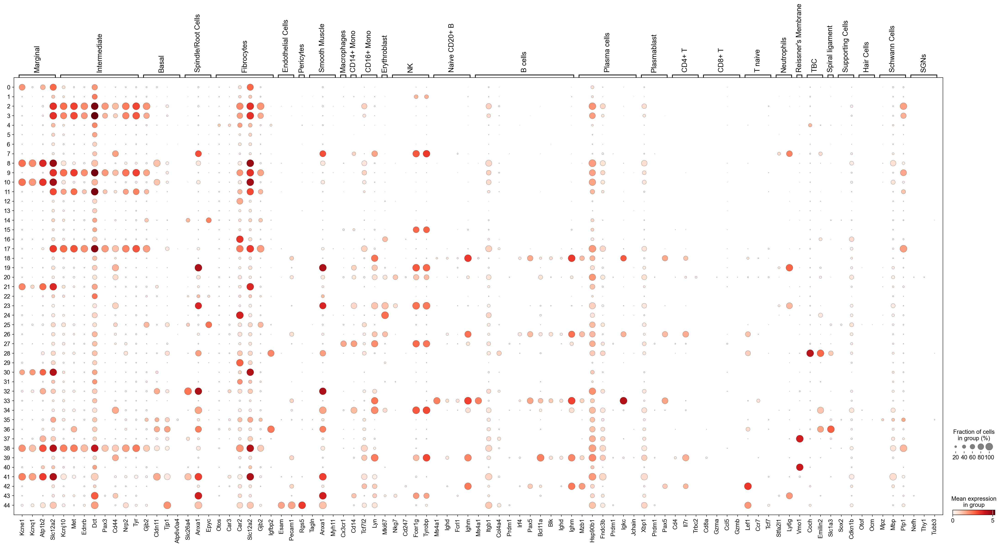

In [36]:
#View marker genes at various Leiden resolutions
sc.pl.dotplot(adata_subset, marker_genes, groupby='leiden_res_0.02');
sc.pl.dotplot(adata_subset, marker_genes, groupby='leiden_res_0.50');
sc.pl.dotplot(adata_subset, marker_genes, groupby='leiden_res_1.00');
sc.pl.dotplot(adata_subset, marker_genes, groupby='leiden_res_2.00');

In [37]:
#identify top DEGs per cluster at res=2 to maximize granularity of empty clusters
sc.tl.rank_genes_groups(adata_subset, groupby="leiden_res_2.00", method="wilcoxon")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/Users/rvi33352/miniforge3/envs/scrnaseq/lib/python3.12/site-packages/scanpy/tools/_rank_genes_grou

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_res_2.00']`


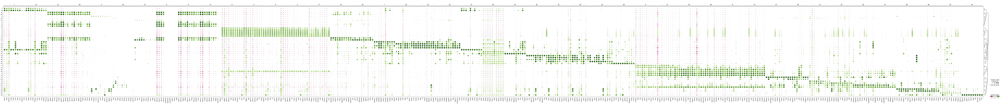

In [38]:
#plot top DEGs per cluster
sc.tl.dendrogram(adata_subset, groupby="leiden_res_2.00")
sc.pl.rank_genes_groups_dotplot(
    adata_subset,
    n_genes=10,
    values_to_plot="logfoldchanges",
    min_logfoldchange=3,
    vmax=7,
    vmin=-7,
    cmap="PiYG",
)

In [39]:
#20 highest DEGs include rRNA
#22, 31
#12, 29, 5, 6, 13 - Hb+

In [40]:
#second sub-clustering, filtering out above clusters
adata_subset2 = adata_subset[adata_subset.obs['leiden_res_2.00'].isin(['0', '1', '2', '3', '4', '7', '8', '9', '10', '14', '15', '16', '17', 
                                                                       '18', '19', '21', '23', '24', '25', '26', '27', '28', '30','32', '33', '34', '35',
                                                                       '36', '37', '38', '39', '40', '41', '42', '43', '44'])]

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing PCA
    with n_comps=50
    finished (0:00:02)


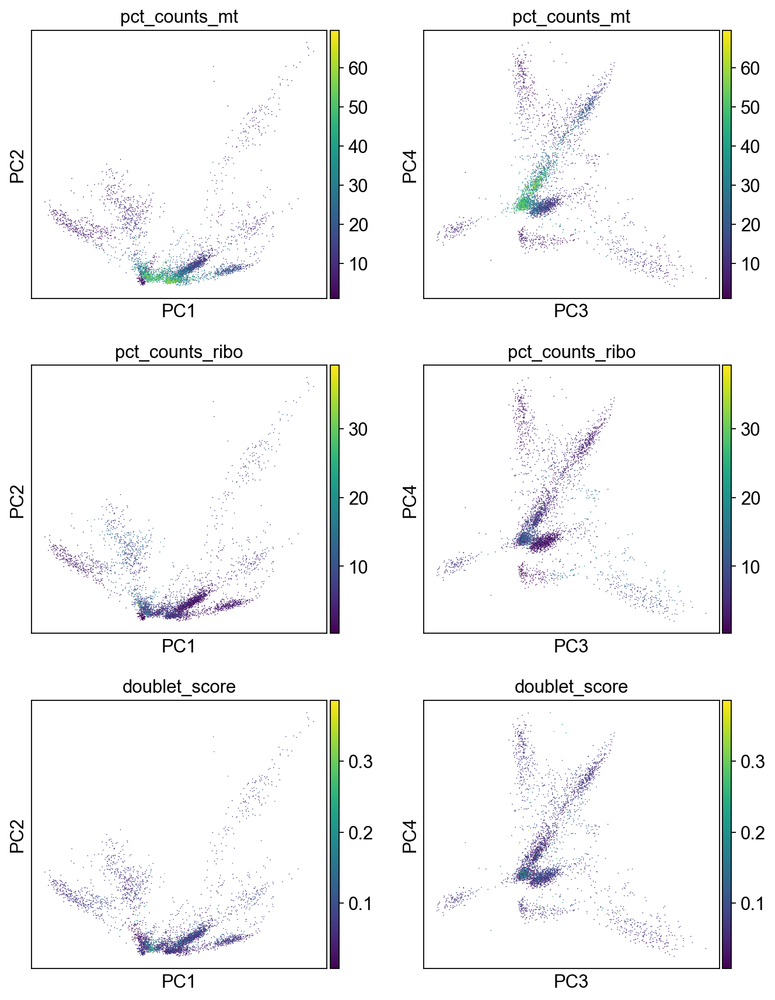

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:03)


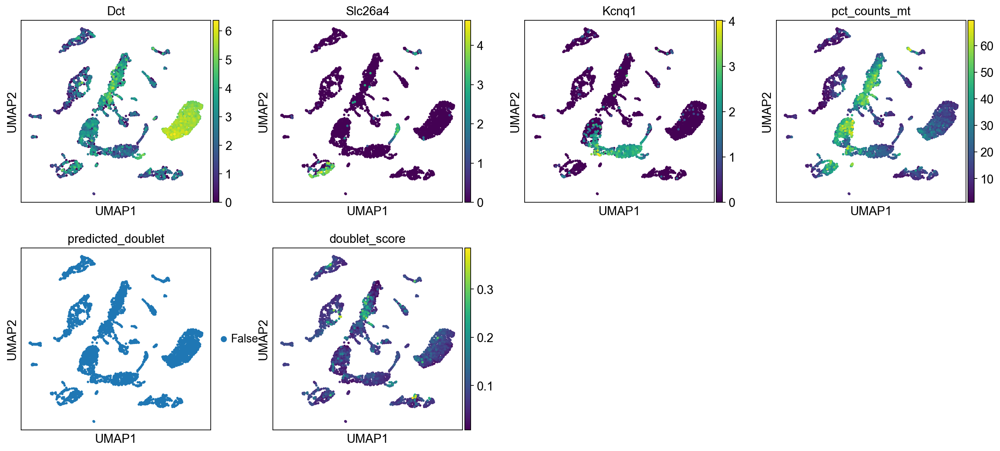

In [41]:
#reprocess remaining cells
sc.pp.neighbors(adata_subset2, n_neighbors=10, n_pcs=20)
sc.tl.pca(adata_subset2, svd_solver='arpack')
#Plot PCA looking at distribution of Mt-pct, ribo-pct, and doublet score in PC1-4
sc.pl.pca(
    adata_subset2,
    color=["pct_counts_mt", "pct_counts_mt", "pct_counts_ribo", "pct_counts_ribo", "doublet_score", "doublet_score"],
    dimensions=[(0, 1), (2, 3), (0, 1), (2, 3), (0, 1), (2, 3)],
    ncols=2,
    size=2,
)
#compute and plot UMAP with SV/LW marker genes
sc.tl.umap(adata_subset2) 
sc.pl.umap(adata_subset2, color=['Dct', 'Slc26a4', 'Kcnq1', "pct_counts_mt", "predicted_doublet", "doublet_score"]) 

In [42]:
adata_subset2

AnnData object with n_obs × n_vars = 3939 × 4638
    obs: 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'leiden_res_0.02', 'leiden_res_0.50', 'leiden_res_1.00', 'leiden_res_2.00'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'scrublet', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'predicted_doublet_colors', 'leiden_res_0.02', 'leiden_res_0.50', 'leiden_res_1.00', 'leiden_res_2.00', 'leiden_res_0.02_colors', 'leiden_res_0.50

In [60]:
sc.tl.leiden(adata_subset2, resolution=0.1)

running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


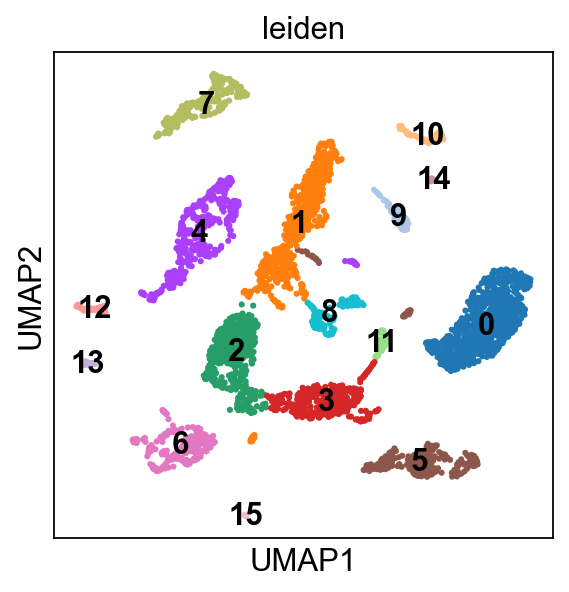

In [61]:
sc.pl.umap(
    adata_subset2,
    color=["leiden"],
    legend_loc="on data",
)

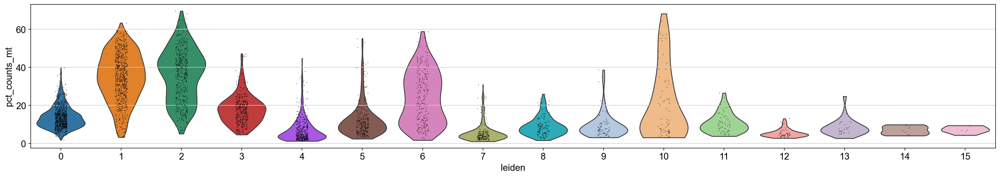

In [62]:
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ["pct_counts_mt"], groupby="leiden")

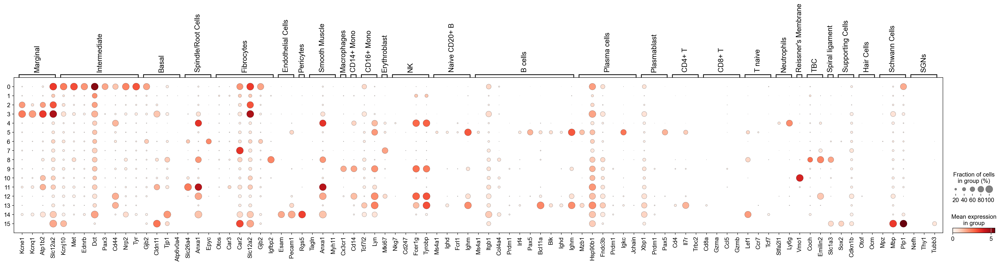

In [63]:
#identify marker genes in clusters
sc.pl.dotplot(adata_subset2, marker_genes, groupby='leiden');

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


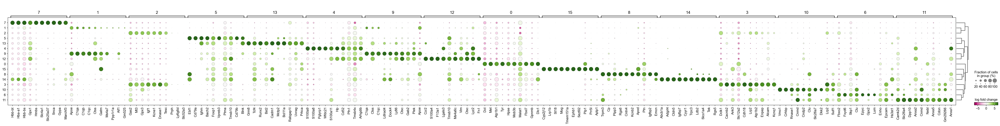

In [64]:
#identify and plot top DEGs per cluster
sc.tl.dendrogram(adata_subset2, groupby="leiden")
sc.tl.rank_genes_groups(adata_subset2, groupby="leiden", method="wilcoxon")
sc.pl.rank_genes_groups_dotplot(
    adata_subset2,
    n_genes=10,
    values_to_plot="logfoldchanges",
    min_logfoldchange=3,
    vmax=7,
    vmin=-7,
    cmap="PiYG",
)

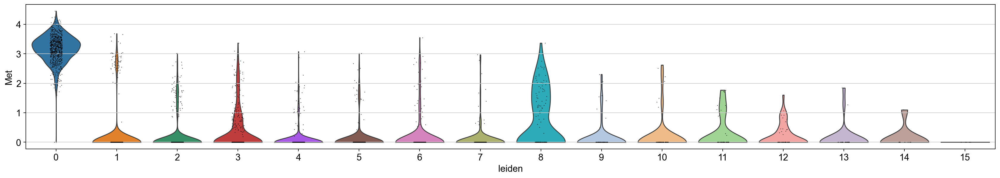

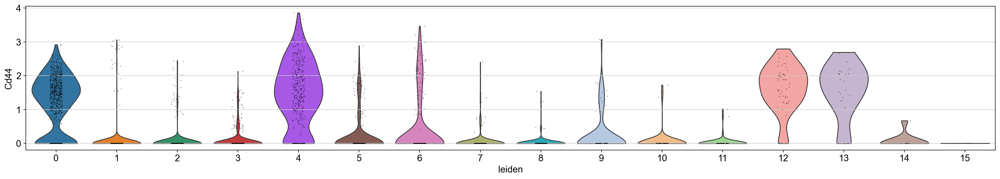

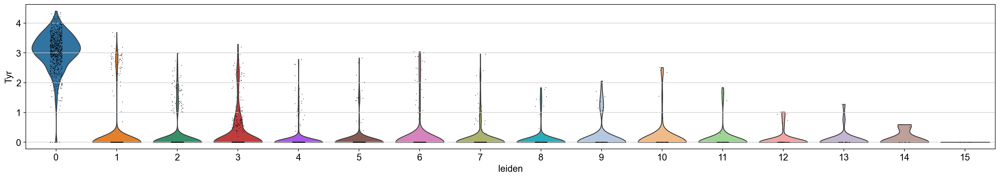

In [65]:
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Met'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Cd44'], groupby='leiden') 
    sc.pl.violin(adata_subset2, ['Tyr'], groupby='leiden') #neural crest marker, Dct was too widespread

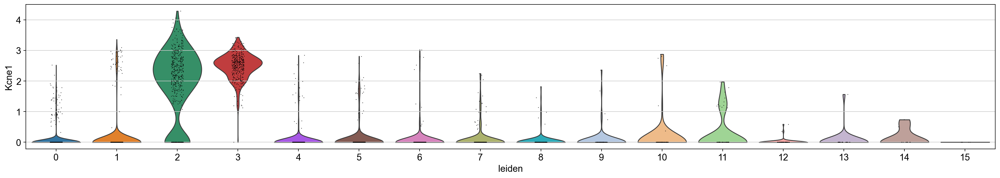

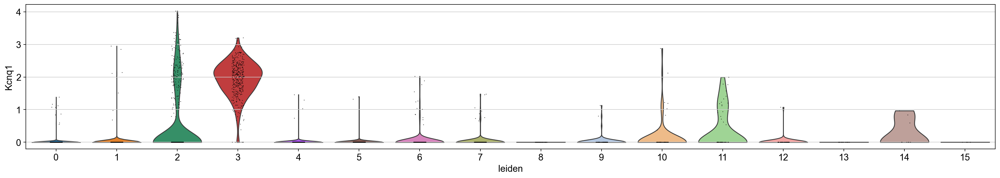

In [66]:
#violin plot looking at MC Markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Kcne1'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Kcnq1'], groupby='leiden')

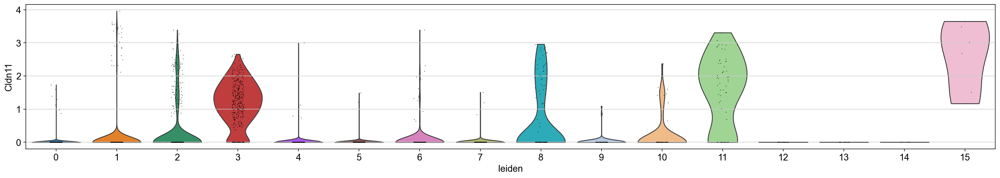

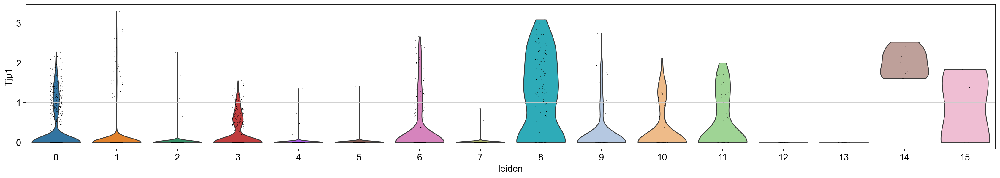

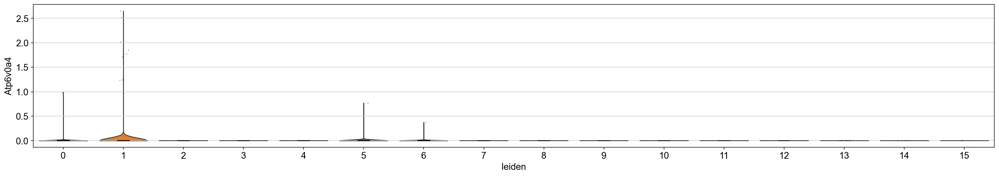

In [67]:
#violin plot looking at BC Markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Cldn11'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Tjp1'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Atp6v0a4'], groupby='leiden')

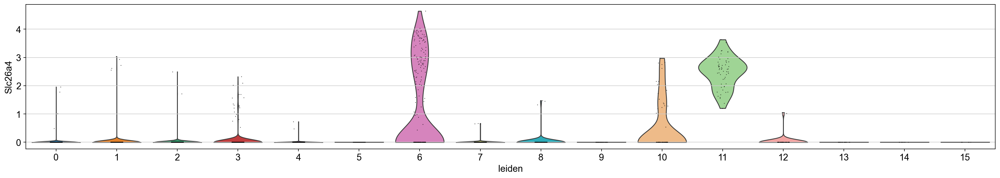

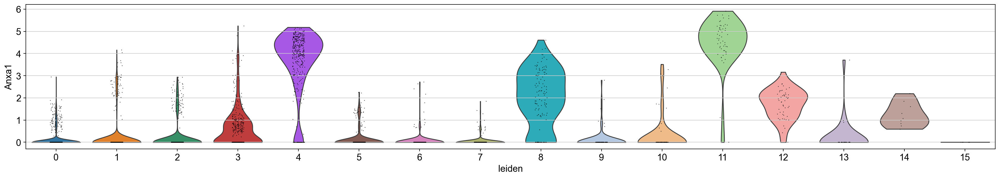

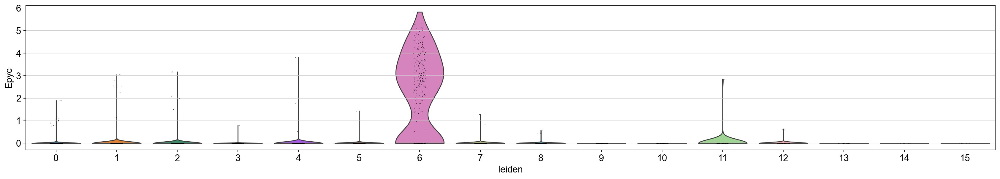

In [68]:
#violin plot looking at Spindle/Root Cell markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Slc26a4'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Anxa1'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Epyc'], groupby='leiden')

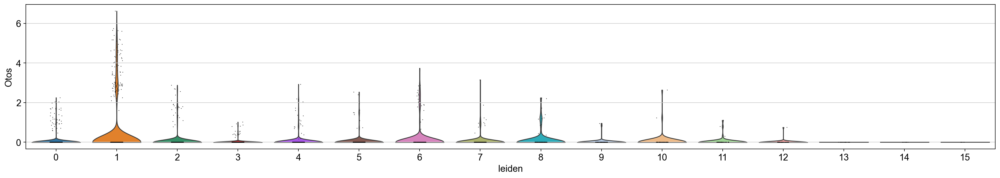

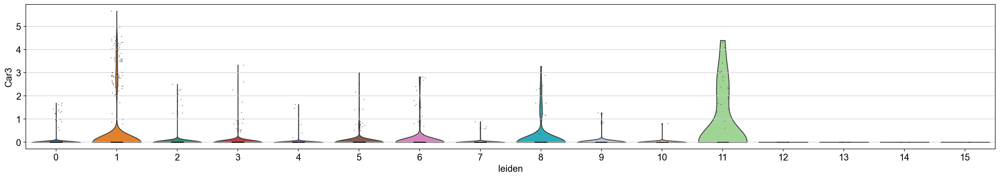

In [69]:
#violin plot looking at Fibrocyte markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Otos'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Car3'], groupby='leiden')

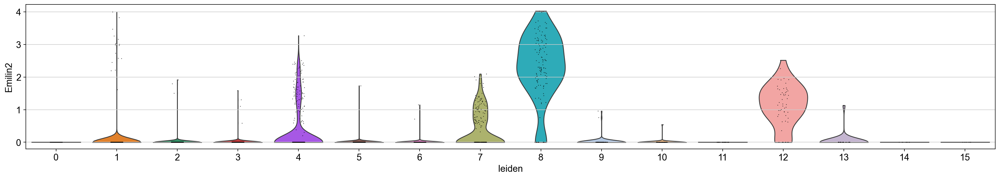

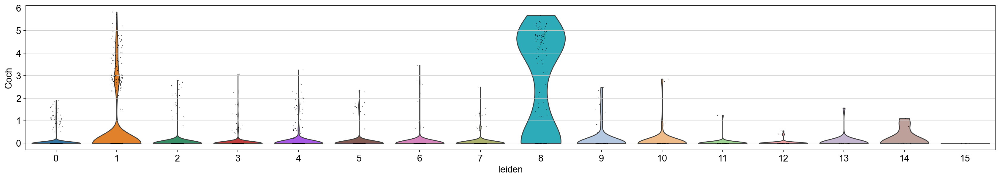

In [70]:
#violin plot looking at TBC/SL markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Emilin2'], groupby='leiden') #TBC
    sc.pl.violin(adata_subset2, ['Coch'], groupby='leiden') #SL

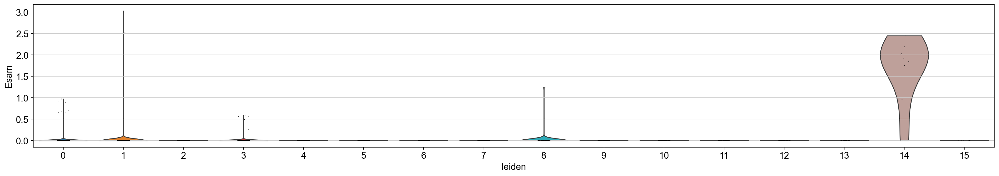

In [71]:
#violin plot looking at Endothelial Cell markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Esam'], groupby='leiden')

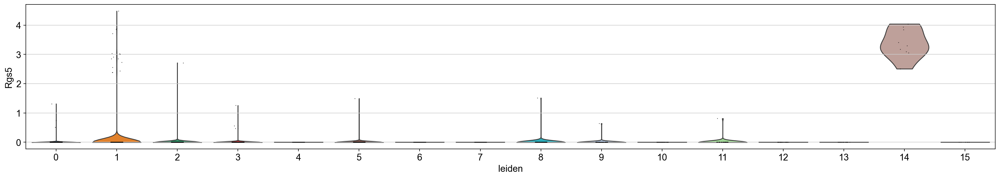

In [72]:
#violin plot looking at Pericyte markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Rgs5'], groupby='leiden')

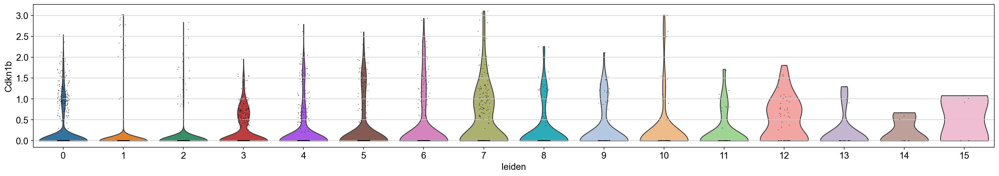

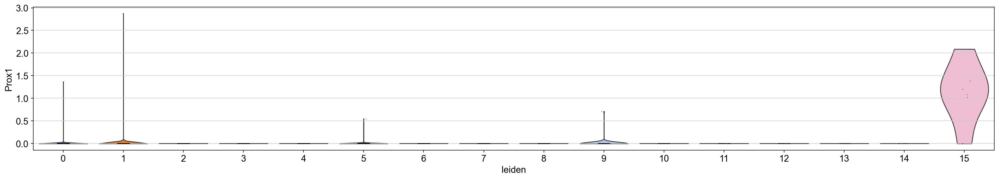

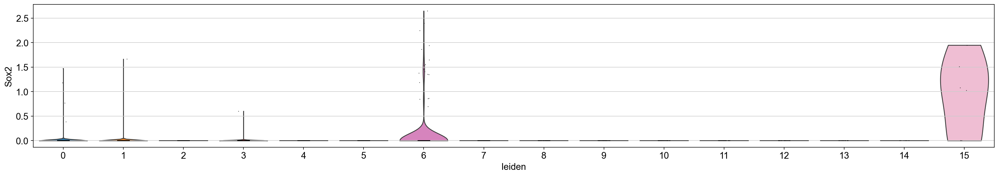

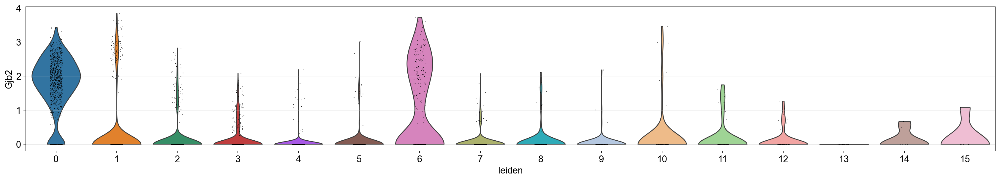

In [73]:
#violin plot looking at Supporting Cell markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Cdkn1b'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Prox1'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Sox2'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Gjb2'], groupby='leiden')

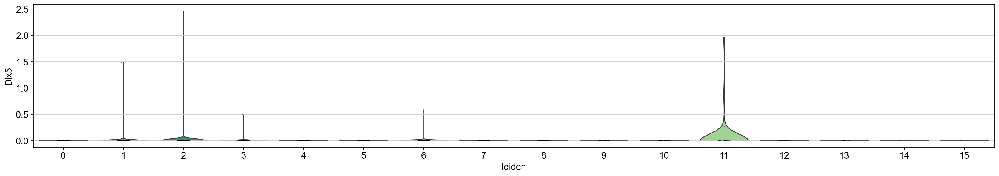

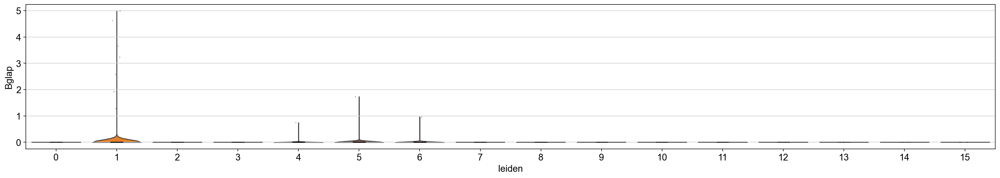

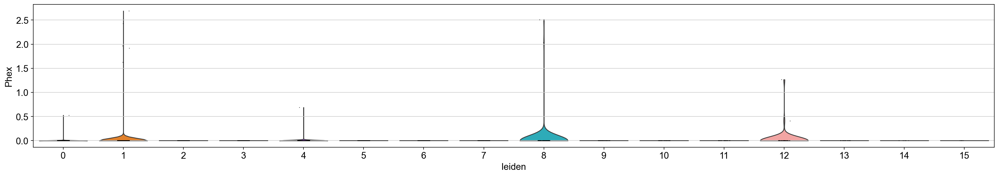

In [74]:
#violin plot looking at Pre/Osteoblast/cyte Cell markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Dlx5'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Bglap'], groupby='leiden')
    sc.pl.violin(adata_subset2, ['Phex'], groupby='leiden')

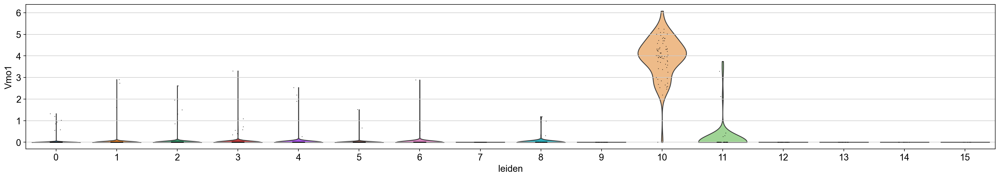

In [75]:
#violin plot looking at Reissner's Membrane Cell markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Vmo1'], groupby='leiden')

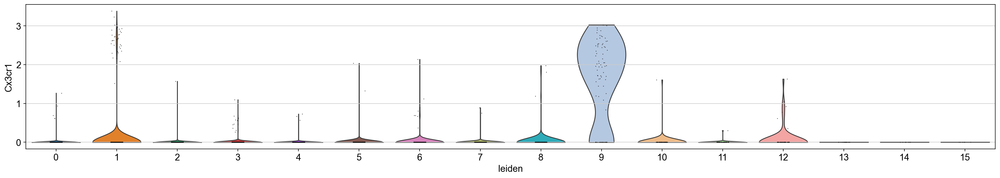

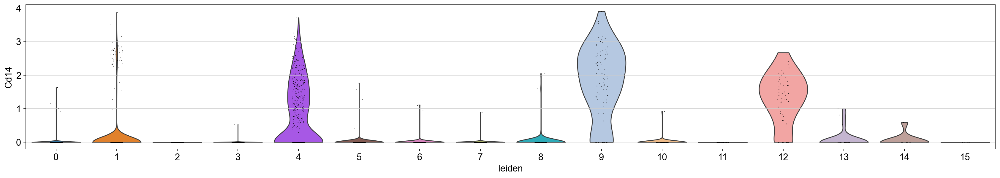

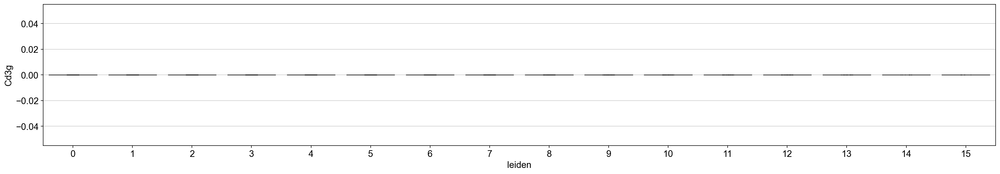

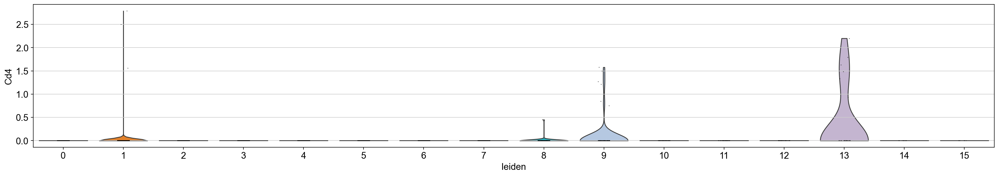

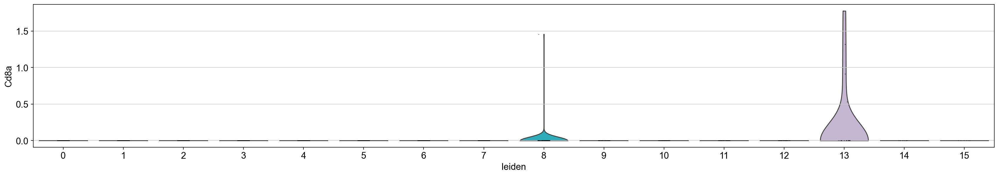

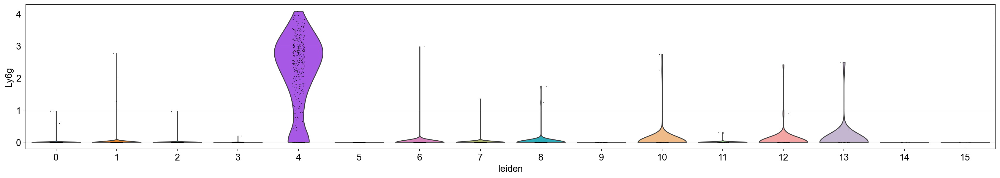

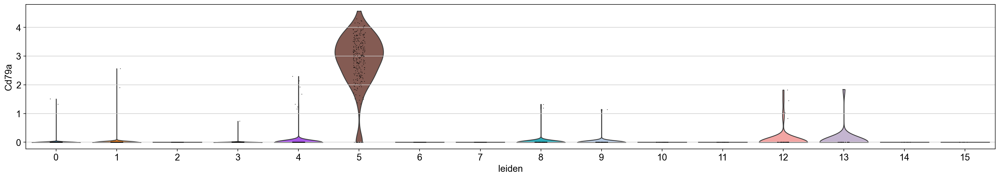

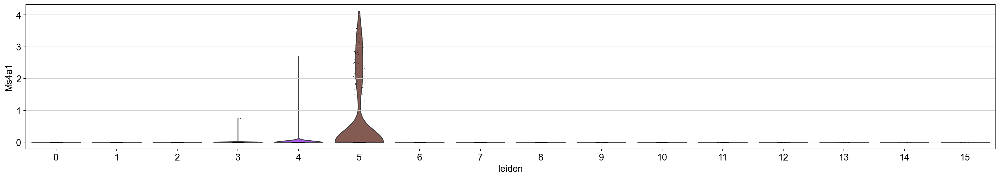

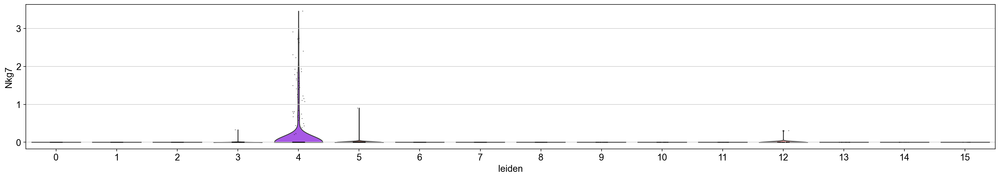

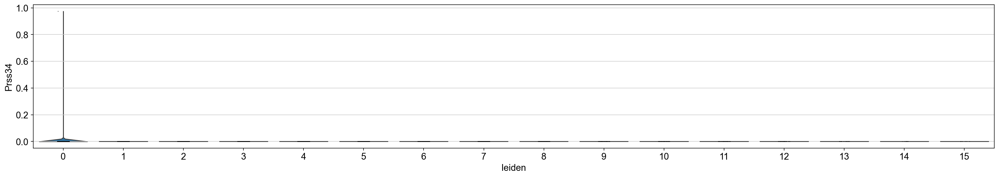

In [76]:
#violin plot looking at Circulating/Immune Cell markers
with mpl.rc_context({'figure.figsize': (20, 4)}):
    sc.pl.violin(adata_subset2, ['Cx3cr1'], groupby='leiden') #resident macrophages
    sc.pl.violin(adata_subset2, ['Cd14'], groupby='leiden') #monocytes
    sc.pl.violin(adata_subset2, ['Cd3g'], groupby='leiden') #T Cells
    sc.pl.violin(adata_subset2, ['Cd4'], groupby='leiden') #Th
    sc.pl.violin(adata_subset2, ['Cd8a'], groupby='leiden') #Tc
    sc.pl.violin(adata_subset2, ['Ly6g'], groupby='leiden') #neutrophils
    sc.pl.violin(adata_subset2, ['Cd79a'], groupby='leiden') #B cells
    sc.pl.violin(adata_subset2, ['Ms4a1'], groupby='leiden') #naive B cell
    sc.pl.violin(adata_subset2, ['Nkg7'], groupby='leiden') #NK
    sc.pl.violin(adata_subset2, ['Prss34'], groupby='leiden') #mast cells

In [77]:
#cell counts by cluster
adata_subset2.obs["leiden"].value_counts()

leiden
0     846
1     722
2     495
3     380
4     379
5     264
6     235
7     202
8     122
9      77
10     69
11     56
12     52
13     25
14      9
15      6
Name: count, dtype: int64

In [78]:
#clusters
#0 IC
#1 Fibrocytes
#2 MC1
#3 MC2
#4  Neutrophils, NK
#5 B Cells
#6 Root Cells
#7 Blood Cells
#8 BC, TBC/SL
#9 Macrophages
#10 Reissner’s Membrane
#11 Spindle Cells
#12 TBC, Monocytes
#13 T Cells
#14 Endothelial, Pericytes
#15 Supporting Cells

In [79]:
#rename clusters
new_cluster_names = ["Intermediate Cells", "Fibrocytes", "Marginal Cells 1", "Marginal Cells 2", "Neutrophils, NK", "B Cells", "Root Cells", "Erythrocytes", "Basal Cells", "Macrophages/Monocytes",
                    "Reissner's Membrane", "Spindle Cells", "TBC", "T Cells", "Endothelial Cells, Pericytes", "Supporting Cells"]
adata_subset2.rename_categories('leiden', new_cluster_names)

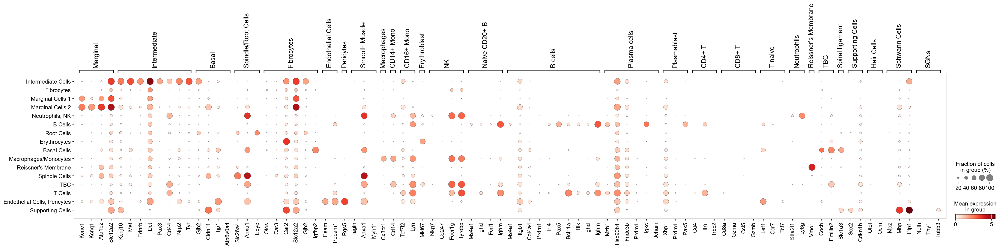

In [80]:
sc.pl.dotplot(adata_subset2, marker_genes, groupby='leiden');

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`
categories: Intermediate Cells, Fibrocytes, Marginal Cells 1, etc.
var_group_labels: Marginal, Intermediate, Basal, etc.


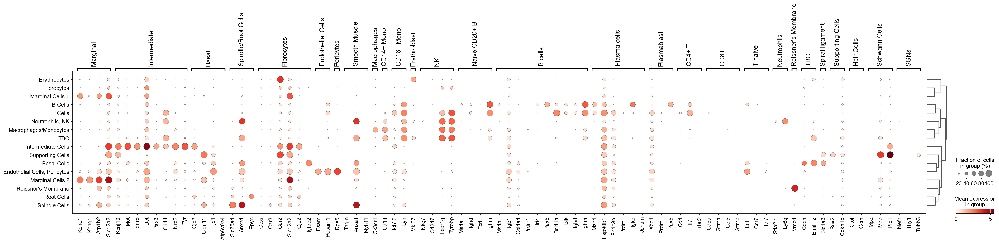

In [81]:
sc.tl.dendrogram(adata_subset2, groupby="leiden")
sc.pl.dotplot(adata_subset2, marker_genes, groupby='leiden', dendrogram=True);

In [84]:
#Gene list obtained from Thulasiram et al 2024 (BioRxiv)
SV_gene_list={
    "Marginal": ["Kcne1", "Kcnq1", "Atp1b2", "Slc12a2", "Ube2s", "Abca2", "Churc1", "Ndufv2", "Slc25a4", "Nme1", "Mettl26", "Qsox1", "Ubl5", "Igfbp7", "Clstn1", "Ndufb10", "Ndufb11",
                "Arf5", "Atp5c1", "Ndufb2", "Cox7b", "Cox7a2", "Atp5b", "Cd59a", "Sorl1", "Itpr2", "Smpdl3a" ,"Mrpl33", "Cox5a", "Uqcrc1", "Mpc2", "Ndufv1", "Prdx5", "Ube2b",
                "Lrp2", "Paqr5", "Atp5j", "Prom2", "Mt3", "Ndufs7", "Ndufb9", "Atp5j2", "Ndufa5", "Rtn4", "Scp2", "Cox5b", "Trnp1", "Snhg4", "Pkm", "Ndufa4", "Mdh1", "Hspa4l", "Hspa1b", "Pgam1",
                "Tspan1", "Ndufb8", "Ndufs6", "Lrpap1", "Etnppl", "Reep5", "Alcam", "Etfb", "Slc41a3", "Atp1b2", "Cox7a1", "Rgs4", "Bglap3", "Tesc", "Dnase1"],
    "Intermediate": ["Kcnj10", "Met", "Ednrb", "Dct", "Pax3", "Cd44", "Nrp2", "Tyr", "Bsg", "Herpud1", "Sdc4", "St6galnac2", "Car2", "Hsp90b1", "Thrsp", "Alpl", "Jam2", "Atp6ap2", "Ctsb", "Psap",
                    "Atp6v0b", "Sparcl1", "Aldh2", "Emp3", "Col5a3", "Slc45a2", "Hspa5", "F3", "Pla2g7", "Gsta2", "C2", "Kcnj10", "Fxyd1", "Tmem176b", "Scn1b", "Tmem176a"],
    "Basal": ["Gjb2", "Cldn11", "Tjp1", "Atp6v0a4", "Slc2a1", "Cdkn1a", "Bag1", "Rhoc", "Tspan15", "Ubxn1", "Srgn", "Plin4", "Tns1", "Gng11", "Tmem256", "Lctl", "Kif5b",
             "Gabarapl2", "Anxa3", "Mrps6", "Hspa1a", "Perp", "Cited4", "Mt1", "Taldo1", "Srebf1", "Trp53i11", "Bri3", "Smim14", "Ctsl", "Ddx3x", "2200002D01Rik", "Lamp1", "S100a13", 
             "Rapgef3", "Tspan8", "Cd82", "Ppia", "Plpp3", "Atp1a2", "Slc5a3", "Cd63", "Actg1", "Sat1", "Pou3f3", "Anxa5", "Tsc22d3", "Insig1", "Acsl3", "Cd81", "Atp1b3",
             "Arhgap29", "Glul", "Cystm1", "Cebpb", "Fat2", "Qpct", "Enah", "Ackr3", "Aif1l", "Efhd1", "Ndrg3", "Dusp1", "Rnf152", "Ptms", "Actn1", "Xpnpep1", "Gstm1", "Ahnak", "Morf4l1",
             "Eif1", "Jund", "Ephx1", "Ctxn3", "Csrp1", "Csrp1", "Becn1", "Nudt4", "Isyna1", "Scd1", "Ppp1r1a", "S100b", "Apod", "Clu", "Gsn"]
}

categories: Intermediate Cells, Fibrocytes, Marginal Cells 1, etc.
var_group_labels: Marginal, Intermediate, Basal


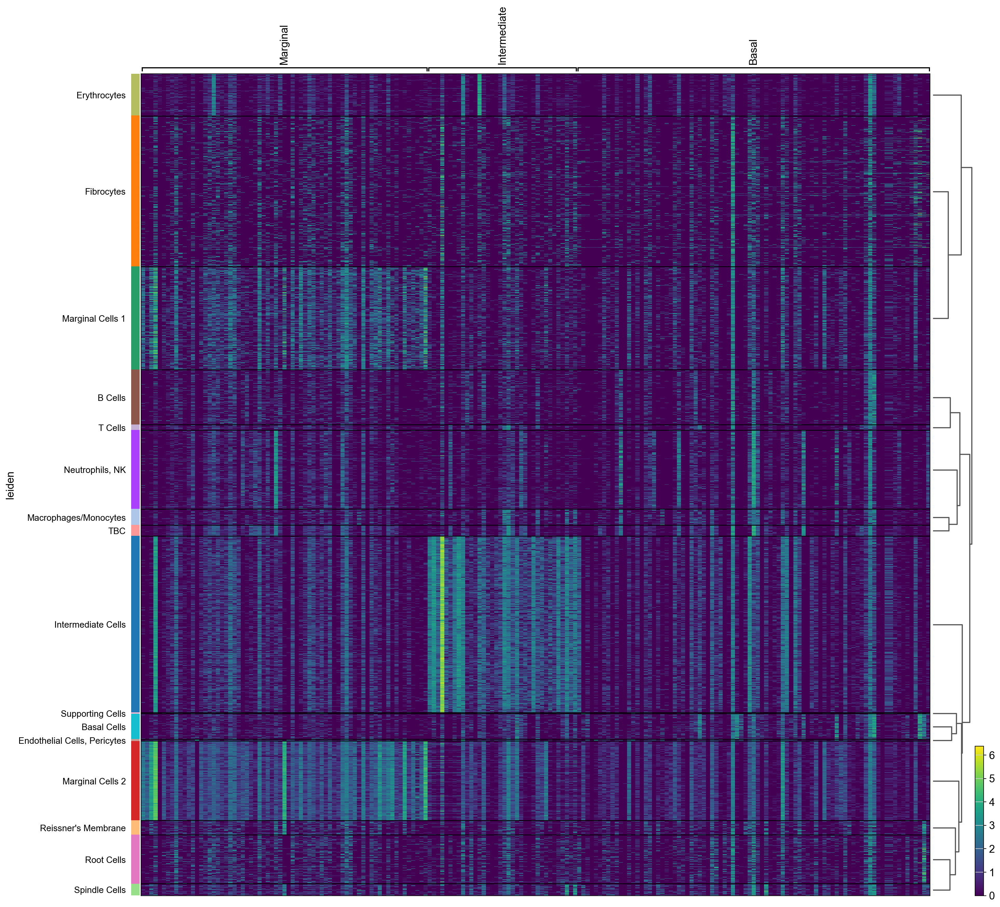

In [93]:
sc.pl.heatmap(adata_subset2, SV_gene_list, groupby="leiden", dendrogram=True, cmap="viridis", figsize=(20,20))